In [1]:
import scanpy as sc

sc_data = sc.read_h5ad('/mnt/c/Users/ouyangkang/Desktop/convert_sc_data.h5ad')

In [2]:
import numpy as np
trajectory_try = sc_data[np.in1d(sc_data.obs['celltype'], ['Malpighian tubule anlage', 'Malpighian tubule primordium', 'Malpighian tubule'])]

In [3]:
trajectory_try

View of AnnData object with n_obs × n_vars = 4717 × 16725
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'cell', 'pANN', 'library', 'RNA_snn_res.0.5', 'seurat_clusters', 'collected_time', 'infer_age', 'infer_age_int', 'tissue_old', 'sub_cluster_number', 'celltype', 'tissue_update', 'germ_layer', 'subtype'
    var: 'vst.mean', 'vst.variance', 'vst.variance.expected', 'vst.variance.standardized', 'vst.variable'
    obsm: 'X_harmony', 'X_pca', 'X_scvi', 'X_umap'

In [4]:
sc.pp.neighbors(trajectory_try, n_neighbors=10)

/home/ouyangkang/software/anaconda3/envs/scRNA/lib/python3.8/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


In [5]:
sc.tl.rank_genes_groups(trajectory_try, 'celltype', method='t-test')

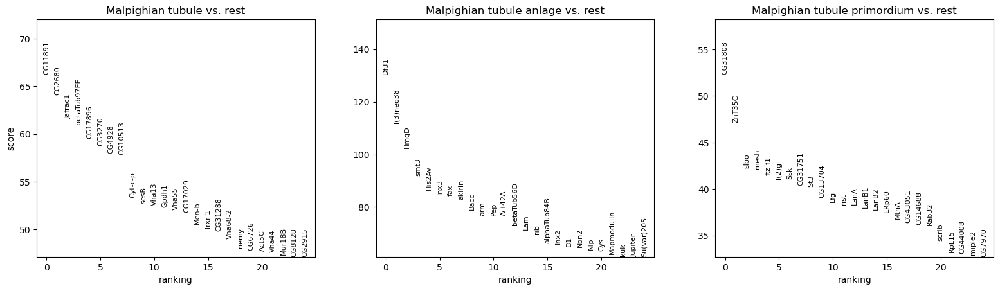

In [6]:
sc.pl.rank_genes_groups(trajectory_try, n_genes=25, sharey=False)

In [7]:
trajectory_try.obs.head()

,orig.ident,nCount_RNA,nFeature_RNA,percent.mt,cell,pANN,library,RNA_snn_res.0.5,seurat_clusters,collected_time,infer_age,infer_age_int,tissue_old,sub_cluster_number,celltype,tissue_update,germ_layer,subtype
index,,,,,,,,,,,,,,,,,,
CELL368_N2_1_1,V2R2209070002,28958.0,3872,1.868223,CELL368_N2_1_1,0.249983031290301,V2R2209070002,19.0,19,E12-14h,12.818030,13.0,Malpighian tubule,1,Malpighian tubule primordium,Malpighian tubule,ectoderm,Malpighian tubule primordium
CELL760_N2_1_1,V2R2209070002,119218.0,6124,1.552618,CELL760_N2_1_1,0.249983031290301,V2R2209070002,19.0,19,E12-14h,12.487479,12.0,Malpighian tubule,1,Malpighian tubule primordium,Malpighian tubule,ectoderm,Malpighian tubule primordium
CELL827_N2_1_1,V2R2209070002,14032.0,2715,1.275656,CELL827_N2_1_1,0.249983031290301,V2R2209070002,22.0,22,E12-14h,14.654424,15.0,endoderm,3,Malpighian tubule anlage,ectoderm,ectoderm,Malpighian tubule anlage
CELL979_N4_1_1,V2R2209070002,184611.0,6734,2.110925,CELL979_N4_1_1,0.249983031290301,V2R2209070002,19.0,19,E12-14h,12.560935,13.0,Malpighian tubule,1,Malpighian tubule primordium,Malpighian tubule,ectoderm,Malpighian tubule primordium
CELL1083_N1_1_1,V2R2209070002,1941.0,713,0.875837,CELL1083_N1_1_1,0.249983031290301,V2R2209070002,19.0,19,E12-14h,13.662771,14.0,Malpighian tubule,1,Malpighian tubule primordium,Malpighian tubule,ectoderm,Malpighian tubule primordium


In [8]:
import pandas as pd

def rank_genes_groups_df(adata, key='rank_genes_groups',subgroup = None):
        dd = []
        groupby = adata.uns[key]['params']['groupby']
        if subgroup != None:
            cate = subgroup
        else:
            cate = adata.obs[groupby].cat.categories
        #print(cate)
        for group in cate:
            cols = []
            # inner loop to make data frame by concatenating the columns per group
            for col in adata.uns[key].keys():
                if col != 'params':
                       cols.append(pd.DataFrame(adata.uns[key][col][str(group)], columns=[col]))
            df = pd.concat(cols,axis=1)
            df['group'] = group
            dd.append(df)
        # concatenate the individual group data frames into one long data frame
        rgg = pd.concat(dd)
        rgg['group'] = rgg['group'].astype('category')
        return rgg

def get_top(df,num):
    top = []
    for i in df['group'].unique().tolist():
        ddf = df[df['group']==i].head(int(num))
        top.append(ddf)
    gene_df = pd.concat(top)
    return gene_df

In [9]:
genes = list(set(rank_genes_groups_df(trajectory_try)['names'].tolist()))

/home/ouyangkang/software/anaconda3/envs/scRNA/lib/python3.8/site-packages/dynamo/plot/time_series.py:361: RuntimeWarning: invalid value encountered in divide
  exprs = (exprs - np.min(exprs, axis=standard_scale)[:, None]) / np.ptp(exprs, axis=standard_scale)[


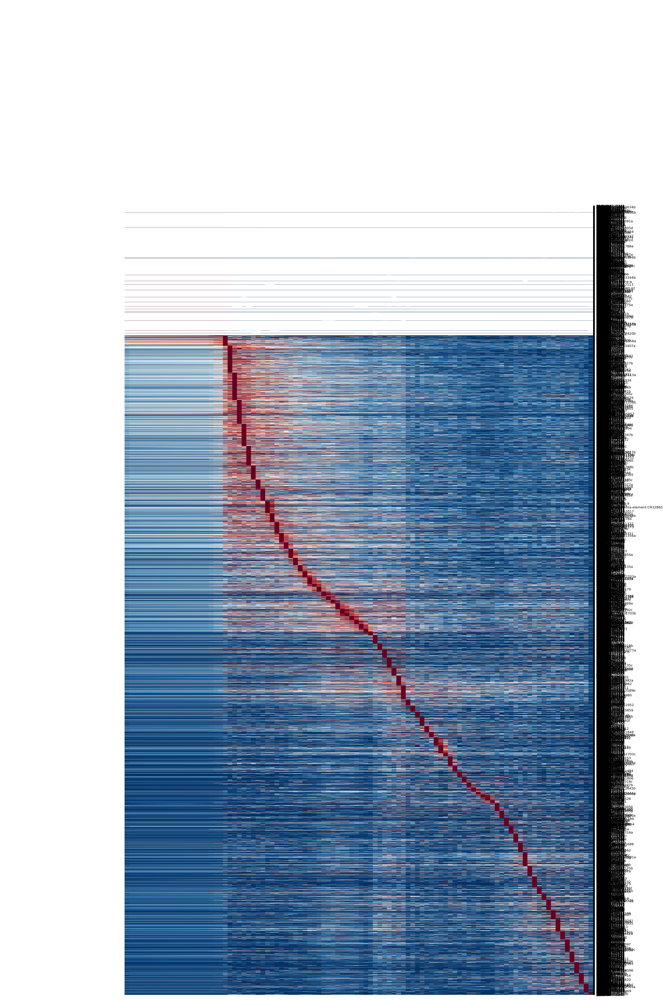

In [10]:
# get matrix 
import dynamo as dyn

dyn.pl.kinetic_heatmap(
    trajectory_try,
    genes = genes,
    basis ='umap',
    mode = 'pseudotime',
    tkey = 'infer_age',
    gene_order_method = 'maximum',
    color_map  = 'RdBu_r',
    show_colorbar =False,
    #dist_threshold  = 3e-10,
    #spaced_num =200,
    figsize =(20,30),
    #enforce =True
)

In [11]:
cluster_data = trajectory_try.uns['kinetics_heatmap']
cluster_data.dropna(axis=0, inplace=True)
cluster_data

,0,1,2,3,4,5,6,7,8,9,...,90,91,92,93,94,95,96,97,98,99
nol,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,0.000000,0.00000,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0
Epac,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,0.000000,0.00000,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0
CG13086,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,0.000000,0.09620,0.0,0.0,0.000000,0.000000,0.114953,0.0,0.0,0.0
asRNA:CR43636,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,0.000000,0.00000,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0
ELOVL,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,0.000000,0.00000,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
lncRNA:CR44986,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.00000,0.0,0.0,0.010595,0.185773,0.000000,0.0,0.0,1.0
Su(var)3-7,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.448248,0.43487,0.0,0.0,0.010595,0.000000,0.394449,0.0,0.0,1.0
asRNA:CR31144,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.00000,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,1.0
CG42764,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.00000,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,1.0


In [98]:
trajectory_try

AnnData object with n_obs × n_vars = 4717 × 16725
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'cell', 'pANN', 'library', 'RNA_snn_res.0.5', 'seurat_clusters', 'collected_time', 'infer_age', 'infer_age_int', 'tissue_old', 'sub_cluster_number', 'celltype', 'tissue_update', 'germ_layer', 'subtype'
    var: 'vst.mean', 'vst.variance', 'vst.variance.expected', 'vst.variance.standardized', 'vst.variable'
    uns: 'neighbors', 'rank_genes_groups', 'kinetics_heatmap'
    obsm: 'X_harmony', 'X_pca', 'X_scvi', 'X_umap'
    obsp: 'distances', 'connectivities'

In [31]:
try_gam = list(range(100))

In [35]:
from pygam import LinearGAM, s

gam_fit_df = pd.DataFrame(np.zeros((14055, 100), dtype=float), index=cluster_data.index)
for gene_name in cluster_data.index:
    y_gam = cluster_data.loc[gene_name, :].values
    gam = LinearGAM(s(0, lam=0.6, n_splines=12), fit_intercept=False).fit(try_gam, y_gam)
    axx = gam.generate_X_grid(term=0, n=100)
    yyy = gam.predict(X=axx)
    gam_fit_df.loc[gene_name, :] = yyy

In [37]:
gam_fit_df

,0,1,2,3,4,5,6,7,8,9,...,90,91,92,93,94,95,96,97,98,99
nol,1.078274,1.077404,1.075616,1.072546,1.067829,1.061102,1.051997,1.040152,1.025200,1.006777,...,-0.000302,-0.000247,-0.000191,-0.000133,-0.000074,-0.000015,0.000045,0.000106,0.000165,0.000225
Epac,1.062977,1.062944,1.062149,1.060282,1.057033,1.052093,1.045152,1.035900,1.024028,1.009225,...,-0.000192,-0.000198,-0.000196,-0.000187,-0.000171,-0.000150,-0.000124,-0.000095,-0.000064,-0.000031
CG13086,1.078275,1.077404,1.075617,1.072547,1.067831,1.061103,1.051998,1.040153,1.025201,1.006778,...,0.010927,0.012113,0.013311,0.014516,0.015720,0.016917,0.018101,0.019264,0.020401,0.021504
asRNA:CR43636,1.078274,1.077404,1.075616,1.072546,1.067829,1.061102,1.051997,1.040152,1.025200,1.006777,...,-0.000302,-0.000247,-0.000191,-0.000133,-0.000074,-0.000015,0.000045,0.000106,0.000165,0.000225
ELOVL,1.078183,1.077342,1.075584,1.072544,1.067857,1.061157,1.052080,1.040260,1.025333,1.006933,...,-0.002062,-0.001808,-0.001521,-0.001206,-0.000868,-0.000510,-0.000137,0.000247,0.000637,0.001029
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
lncRNA:CR44986,-0.027777,-0.024727,-0.021453,-0.017891,-0.013978,-0.009650,-0.004844,0.000503,0.006455,0.013074,...,0.064548,0.076432,0.089953,0.105034,0.121597,0.139565,0.158861,0.179406,0.201124,0.223938
Su(var)3-7,-0.000175,-0.000105,-0.000035,0.000033,0.000099,0.000163,0.000222,0.000277,0.000327,0.000370,...,0.181736,0.191379,0.201399,0.211838,0.222736,0.234135,0.246076,0.258600,0.271748,0.285562
asRNA:CR31144,-0.006278,-0.005797,-0.005256,-0.004638,-0.003923,-0.003091,-0.002124,-0.001001,0.000297,0.001788,...,0.035452,0.049626,0.065442,0.082821,0.101682,0.121945,0.143528,0.166352,0.190336,0.215400
CG42764,0.000596,0.000573,0.000543,0.000505,0.000455,0.000392,0.000313,0.000215,0.000097,-0.000044,...,0.035558,0.049845,0.065752,0.083199,0.102110,0.122406,0.144010,0.166842,0.190826,0.215884


In [42]:
len(set(rank_genes_groups_df(trajectory_try)['names'].tolist()))

16725

In [43]:
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt

cmap = sns.color_palette( "ch:start=.2,rot=-.3", n_colors=1_000)
sns.set_context( context='paper')
sns.set(rc={'axes.facecolor':'white', 'figure.facecolor':'lightgrey'})

/home/ouyangkang/software/anaconda3/envs/scRNA/lib/python3.8/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


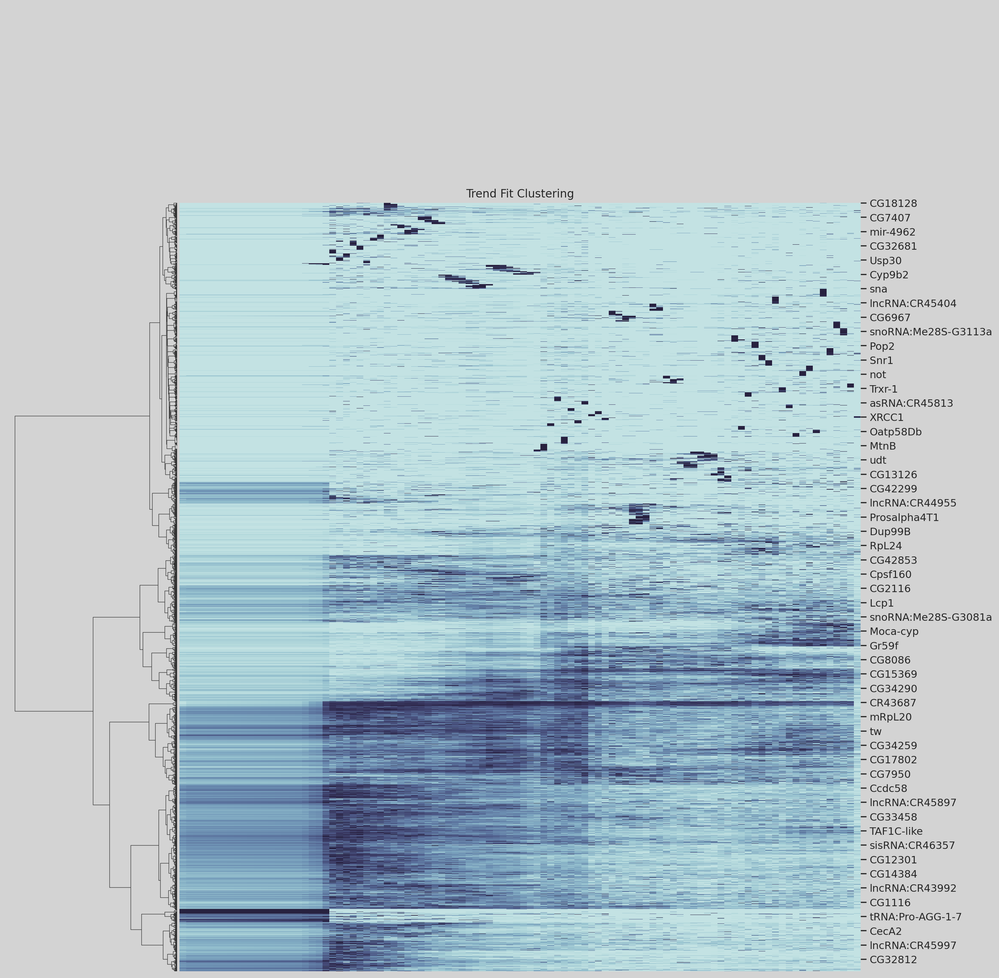

In [44]:
# using seaborn clustermap, which uses scipy hierarchical clustering
# this will take a while to run
ax = sns.clustermap( cluster_data, metric='euclidean', method='ward', col_cluster=False, row_cluster=True, cmap=cmap, figsize=(15,15), standard_scale=0)
ax.cax.set_visible(False)
num_stages = 6
ticks = np.linspace(0, cluster_data.shape[1], num_stages)
ax.ax_heatmap.set_xticks( ticks);
# ax.ax_heatmap.set_xticklabels( adata.uns['stage_order'], rotation=90);
ax.ax_row_dendrogram.set_visible(True)
plt.setp( ax.ax_heatmap.yaxis.get_majorticklabels(), rotation=0)
ax.ax_heatmap.set_title( "Trend Fit Clustering");

In [45]:
import matplotlib.cm as cm
import matplotlib as mp

# set colors used in manuscript
tttt = cm.get_cmap('tab20', 20)
tab20 = []
for i in range(tttt.N):
    rgba = tttt(i)
    tab20.append( mp.colors.rgb2hex(rgba))

/tmp/ipykernel_25622/2254192197.py:5: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  tttt = cm.get_cmap('tab20', 20)


In [46]:
from scipy.cluster import hierarchy

dend_link = ax.dendrogram_row.linkage
cut_tree = hierarchy.cut_tree(dend_link, height=30).squeeze()
u_clust = np.unique(cut_tree)
cut_tree

array([0, 0, 0, ..., 1, 1, 1])

In [47]:
devDEGs_df = pd.DataFrame()
devDEGs_df['gene_name'] = [i for i in cluster_data.index]
devDEGs_df['gene_trend'] = cut_tree
devDEGs_df.head()

,gene_name,gene_trend
0,Mob4,0
1,CG12209,0
2,Kif3C,0
3,Slip1,0
4,CG7692,0


In [48]:
row_order = (hierarchy.leaves_list(dend_link))
_, idx = np.unique(cut_tree[row_order], return_index=True)
cluster_order = cut_tree[row_order][np.sort(idx)]
cluster_order

array([ 1,  3,  9,  2, 12, 11, 10,  8,  4,  7,  5,  0,  6])

In [49]:
# format cluster colors for plotting
lut = dict( zip( cluster_order, tab20))
row_colors = pd.Series( cut_tree).map( lut)

Text(0.5, 1.0, 'Clustered Trend Fits')

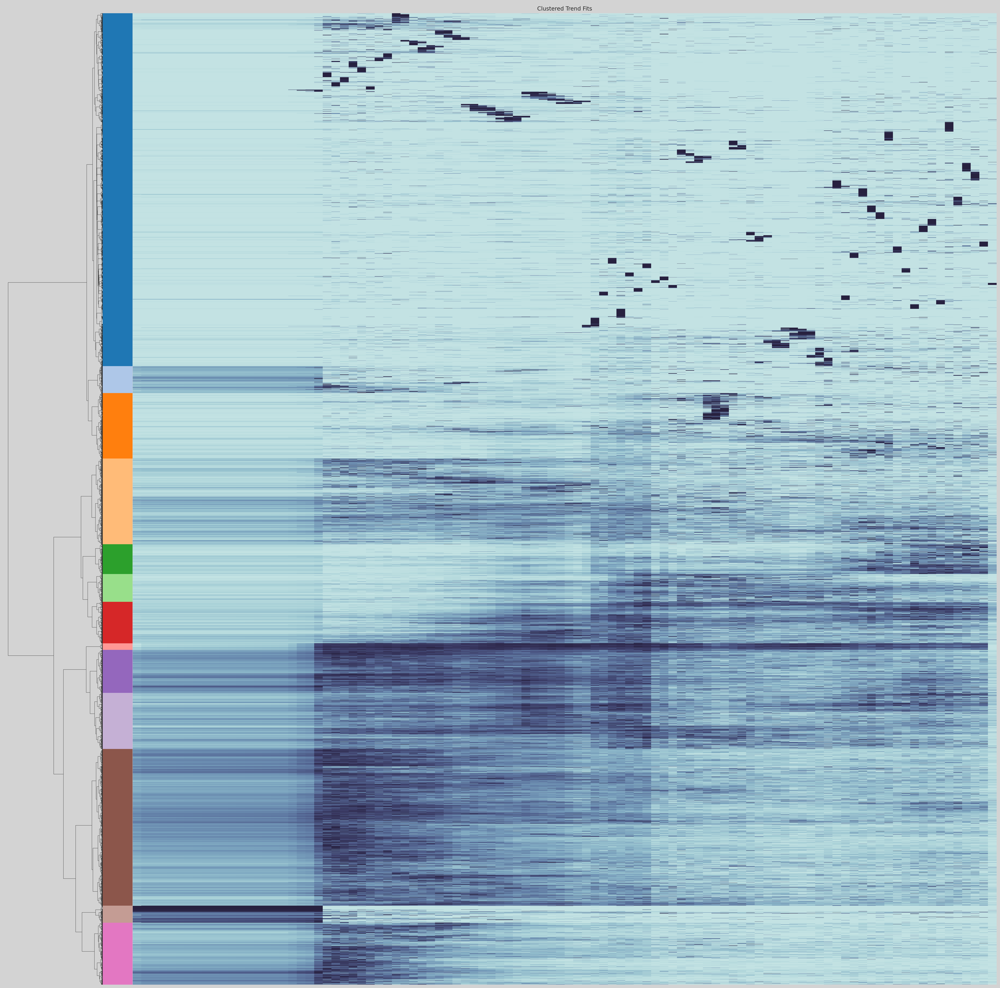

In [50]:
ax = sns.clustermap( cluster_data.reset_index(drop=True), row_linkage=dend_link, row_colors=row_colors, col_cluster=False, 
                     row_cluster=True, cmap=cmap, figsize=(30,30), standard_scale=0, 
                     yticklabels=[], cbar_pos=None, dendrogram_ratio=(0.10,0.01))
num_stages = 6
ticks = np.linspace(0, 100, num_stages)
ax.ax_heatmap.set_xticks( ticks);
# ax.ax_heatmap.set_xticklabels( adata.uns['stage_order'], rotation=90);
ax.ax_row_dendrogram.set_visible(True)
plt.setp( ax.ax_heatmap.yaxis.get_majorticklabels(), rotation=0)
ax.ax_heatmap.set_title( "Clustered Trend Fits")

In [51]:
# trend cluster
down = ['1', '6', '7']
inter_down = ['5', '9']
inter_up = ['0', '2', '4', '8', '12']
up = ['3', '10', '11']

In [52]:
from sklearn import preprocessing
# genes can be list/array of ints or gene names 
def plot_tend_avg( genes, trend_df, scat_df=None, color='green', alpha=1.0):
    min_max_scaler = preprocessing.MinMaxScaler()
    plt.figure( figsize=(4.625*3,4.625)) #, facecolor='white')
    # plot trend fit
    trends = trend_df.loc[genes,:]
    norm_td = min_max_scaler.fit_transform( trends.T)
    avg_td = np.mean( norm_td, axis=1)
    plt.plot( norm_td, linewidth=1.0, alpha=0.01, color=color)
    plt.plot( avg_td, linewidth=2.5, alpha=alpha, color='black')

    num_stages = 20 # len( adata.uns['stage_order'])
    ticks = np.linspace(0, 100, num_stages)
    plt.xticks( ticks, [""]*len(ticks))
    return

In [53]:
import matplotlib as mpl
mpl.rcParams.update(mpl.rcParamsDefault)
mpl.style.use('seaborn-whitegrid')
n_grid_pts = 100
# plt.rcParams['axes.facecolor'] = 'white'
for clust_itr in cluster_order:
    clust_mk = cut_tree==clust_itr
    print( clust_itr, sum(clust_mk))
    clust_genes = cluster_data.index[clust_mk]
    plot_tend_avg( clust_genes, cluster_data, alpha=0.9, color=lut[clust_itr])
    plt.title( clust_itr)
    plt.ylim(0.0,1.0)
    plt.xlim(0,n_grid_pts-1)
    # plt.savefig( f"../path/out/trend-clust_height-90_{clust_itr}_trend-plots.png", format='png', bbox_inches='tight')num_stages = len( np.unique( logTMMs['L4_RORB'].columns))
ticks = np.linspace(0, n_grid_pts-1, num_stages)
plt.xticks( ticks=ticks,labels=[1,2,3,4,5,6], rotation=90)
# have to the last one to get x-labels
# plt.savefig( f"../path/out/trend-clust_height-90_{clust_itr}_trend-plots.png", format='png', bbox_inches='tight')

/tmp/ipykernel_25622/2152104410.py:3: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  mpl.style.use('seaborn-whitegrid')


1 5107
3 389
9 946
2 1240
12 431
11 402
10 601
8 95
4 623
7 810
5 2268
0 247
6 896


([<matplotlib.axis.XTick at 0x7f5ba3e9e730>,
 [Text(0.0, 0, '1'),
  Text(19.8, 0, '2'),
  Text(39.6, 0, '3'),
  Text(59.400000000000006, 0, '4'),
  Text(79.2, 0, '5'),
  Text(99.0, 0, '6')])

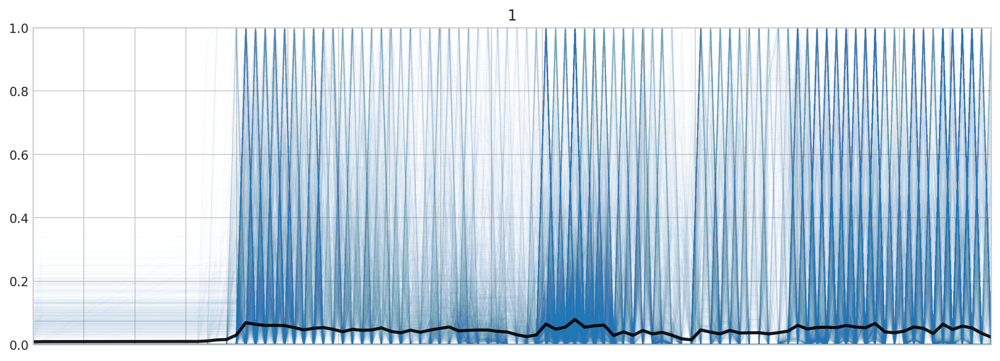

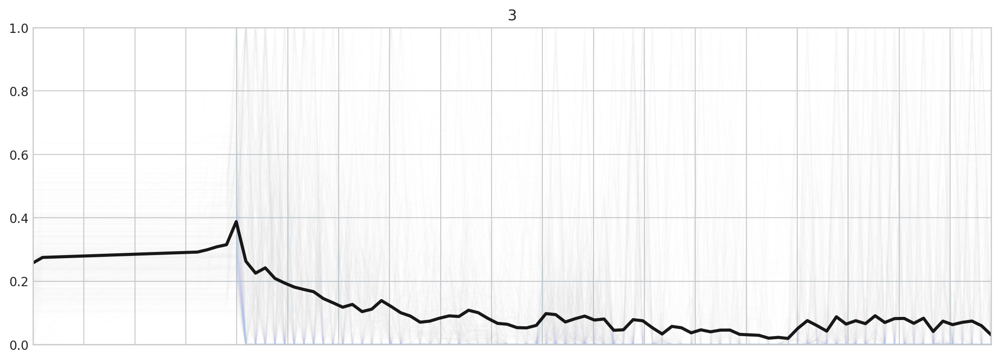

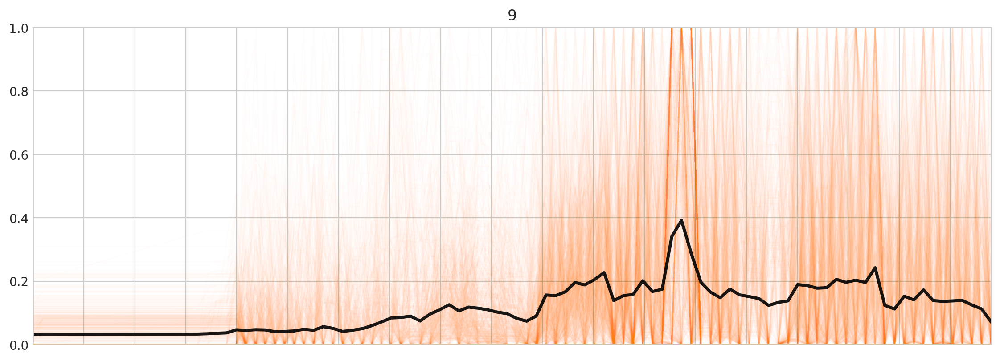

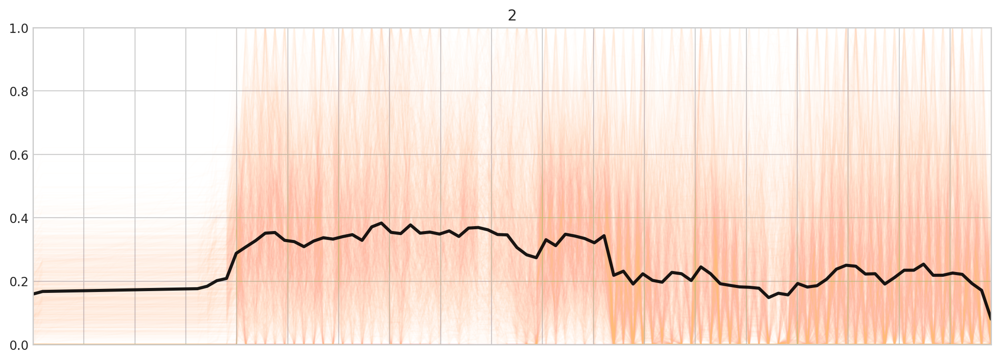

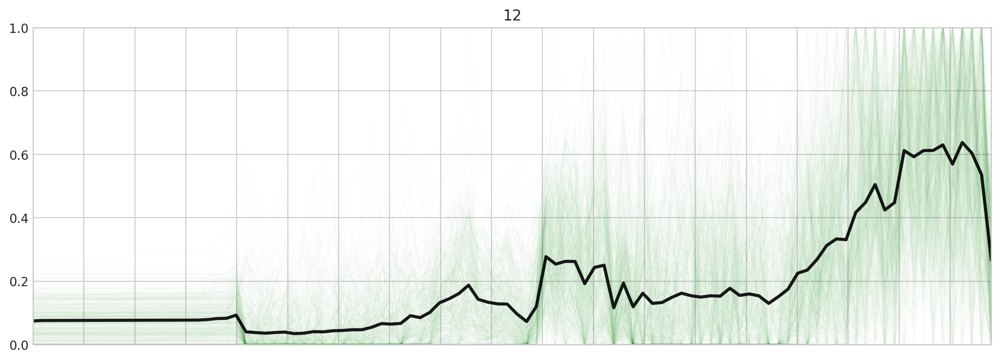

...

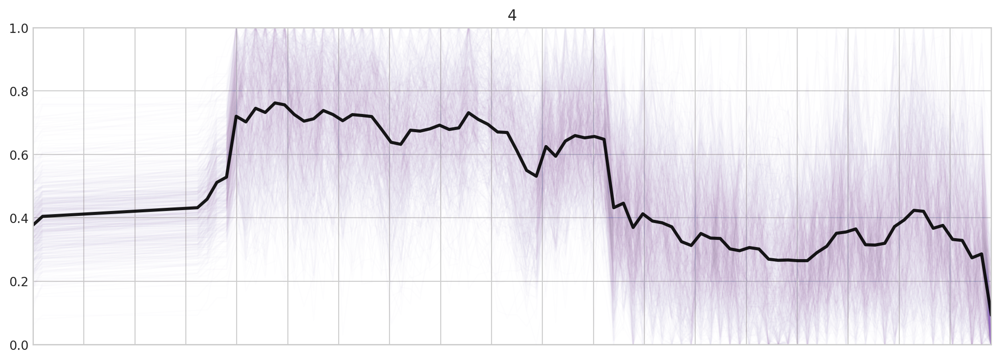

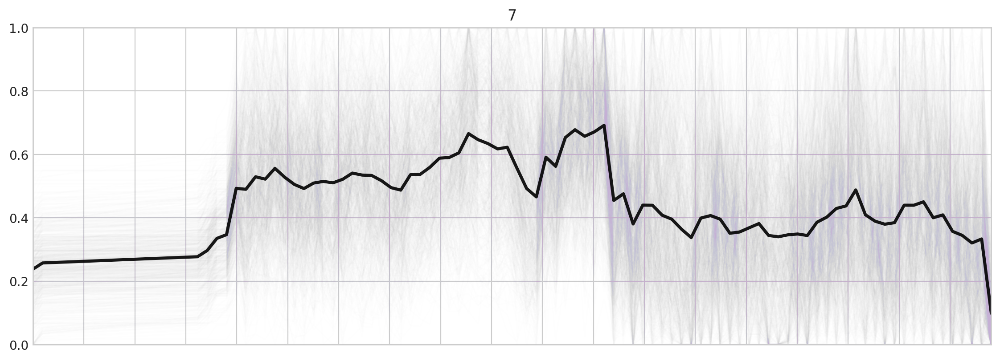

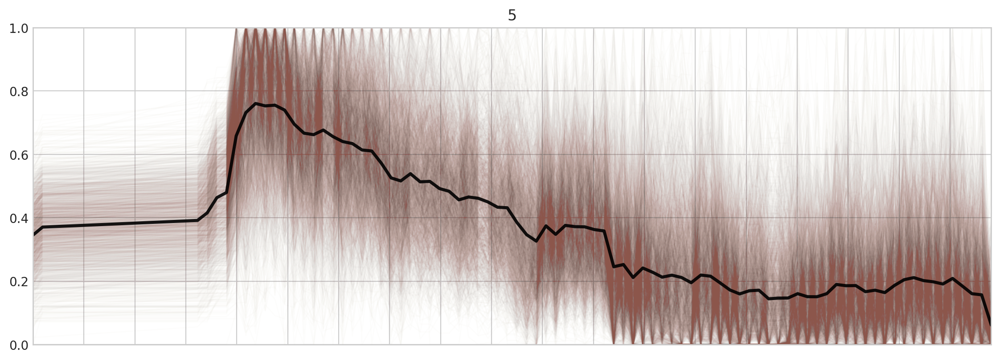

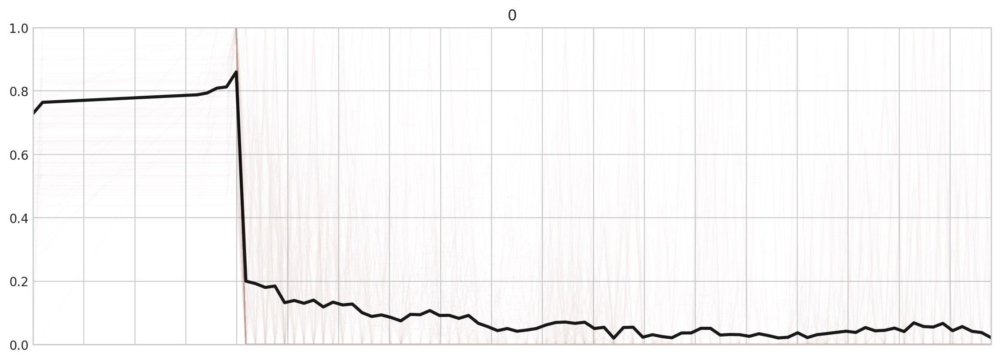

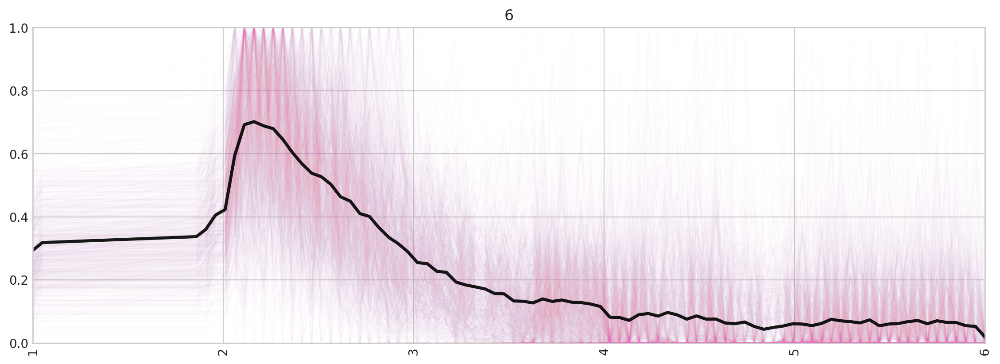

In [54]:
plt.show()

## gam fit dataframe to do download analysis

In [38]:
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt

cmap = sns.color_palette( "ch:start=.2,rot=-.3", n_colors=1_000)
sns.set_context( context='paper')
sns.set(rc={'axes.facecolor':'white', 'figure.facecolor':'lightgrey'})

/home/ouyangkang/software/anaconda3/envs/scRNA/lib/python3.8/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


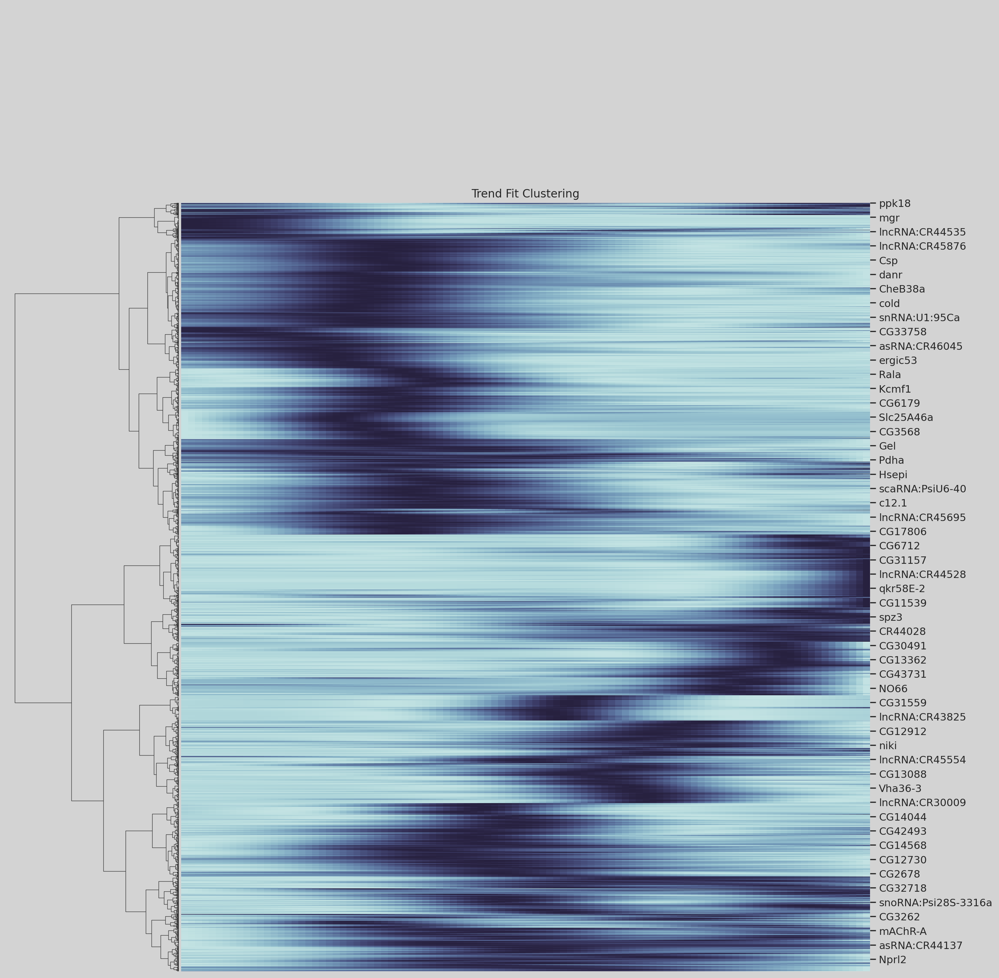

In [39]:
# using seaborn clustermap, which uses scipy hierarchical clustering
# this will take a while to run
ax = sns.clustermap( gam_fit_df, metric='euclidean', method='ward', col_cluster=False, row_cluster=True, cmap=cmap, figsize=(15,15), standard_scale=0)
ax.cax.set_visible(False)
num_stages = 6
ticks = np.linspace(0, gam_fit_df.shape[1], num_stages)
ax.ax_heatmap.set_xticks( ticks);
# ax.ax_heatmap.set_xticklabels( adata.uns['stage_order'], rotation=90);
ax.ax_row_dendrogram.set_visible(True)
plt.setp( ax.ax_heatmap.yaxis.get_majorticklabels(), rotation=0)
ax.ax_heatmap.set_title( "Trend Fit Clustering");

In [47]:
import matplotlib.cm as cm
import matplotlib as mp

# set colors used in manuscript
tttt = cm.get_cmap('tab20', 20)
tab20 = []
for i in range(tttt.N):
    rgba = tttt(i)
    tab20.append( mp.colors.rgb2hex(rgba))

/tmp/ipykernel_541/2254192197.py:5: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  tttt = cm.get_cmap('tab20', 20)


In [67]:
from scipy.cluster import hierarchy

dend_link = ax.dendrogram_row.linkage
cut_tree = hierarchy.cut_tree(dend_link, height=60).squeeze()
u_clust = np.unique(cut_tree)
cut_tree

array([0, 0, 0, ..., 8, 8, 6])

In [68]:
devDEGs_df = pd.DataFrame()
devDEGs_df['gene_name'] = [i for i in gam_fit_df.index]
devDEGs_df['gene_trend'] = cut_tree
devDEGs_df.head()

,gene_name,gene_trend
0,nol,0
1,Epac,0
2,CG13086,0
3,asRNA:CR43636,0
4,ELOVL,0


In [69]:
row_order = (hierarchy.leaves_list(dend_link))
_, idx = np.unique(cut_tree[row_order], return_index=True)
cluster_order = cut_tree[row_order][np.sort(idx)]
cluster_order

array([ 0,  4,  1,  3,  8,  9, 10,  7,  5,  6,  2])

In [70]:
# format cluster colors for plotting
lut = dict( zip( cluster_order, tab20))
row_colors = pd.Series( cut_tree).map( lut)

In [71]:
ax = sns.clustermap( gam_fit_df.reset_index(drop=True), row_linkage=dend_link, row_colors=row_colors, col_cluster=False, 
                     row_cluster=True, cmap=cmap, figsize=(30,30), standard_scale=0, 
                     yticklabels=[], cbar_pos=None, dendrogram_ratio=(0.10,0.01))
num_stages = 6
ticks = np.linspace(0, 100, num_stages)
ax.ax_heatmap.set_xticks( ticks);
# ax.ax_heatmap.set_xticklabels( adata.uns['stage_order'], rotation=90);
ax.ax_row_dendrogram.set_visible(True)
plt.setp( ax.ax_heatmap.yaxis.get_majorticklabels(), rotation=0)
ax.ax_heatmap.set_title( "Clustered Trend Fits")

Text(0.5, 1.0, 'Clustered Trend Fits')

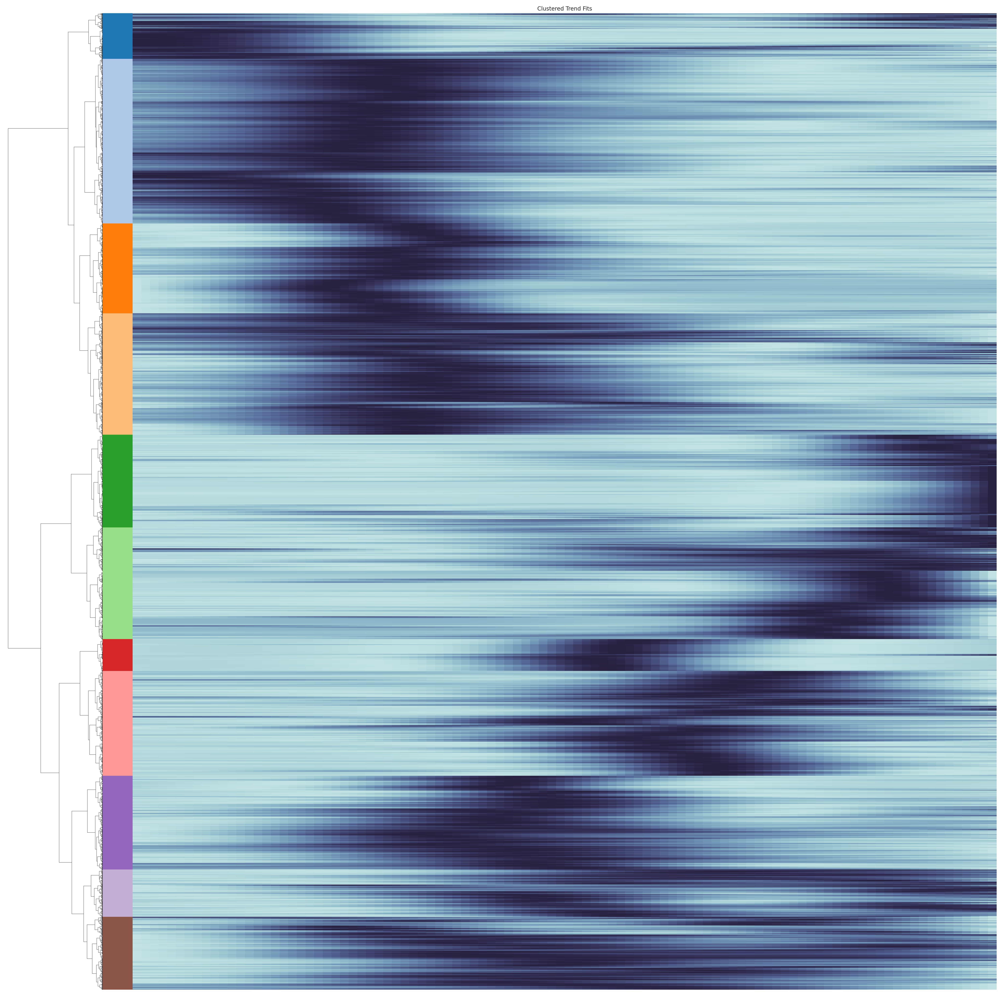

In [72]:
plt.show()

In [73]:
# trend cluster
down = ['1', '6', '7']
inter_down = ['5', '9']
inter_up = ['0', '2', '4', '8']
up = ['3', '10']

In [74]:
from sklearn import preprocessing
# genes can be list/array of ints or gene names 
def plot_tend_avg( genes, trend_df, scat_df=None, color='green', alpha=1.0):
    min_max_scaler = preprocessing.MinMaxScaler()
    plt.figure( figsize=(4.625*3,4.625)) #, facecolor='white')
    # plot trend fit
    trends = trend_df.loc[genes,:]
    norm_td = min_max_scaler.fit_transform( trends.T)
    avg_td = np.mean( norm_td, axis=1)
    plt.plot( norm_td, linewidth=1.0, alpha=0.01, color=color)
    plt.plot( avg_td, linewidth=2.5, alpha=alpha, color='black')

    num_stages = 20 # len( adata.uns['stage_order'])
    ticks = np.linspace(0, 100, num_stages)
    plt.xticks( ticks, [""]*len(ticks))
    return

In [75]:
import matplotlib as mpl
mpl.rcParams.update(mpl.rcParamsDefault)
mpl.style.use('seaborn-whitegrid')
n_grid_pts = 100
# plt.rcParams['axes.facecolor'] = 'white'
for clust_itr in cluster_order:
    clust_mk = cut_tree==clust_itr
    print( clust_itr, sum(clust_mk))
    clust_genes = gam_fit_df.index[clust_mk]
    plot_tend_avg( clust_genes, gam_fit_df, alpha=0.9, color=lut[clust_itr])
    plt.title( clust_itr)
    plt.ylim(0.0,1.0)
    plt.xlim(0,n_grid_pts-1)
    # plt.savefig( f"../path/out/trend-clust_height-90_{clust_itr}_trend-plots.png", format='png', bbox_inches='tight')num_stages = len( np.unique( logTMMs['L4_RORB'].columns))
ticks = np.linspace(0, n_grid_pts-1, num_stages)
plt.xticks( ticks=ticks,labels=[1,2,3,4,5,6], rotation=90)
# have to the last one to get x-labels
# plt.savefig( f"../path/out/trend-clust_height-90_{clust_itr}_trend-plots.png", format='png', bbox_inches='tight')

/tmp/ipykernel_541/780852845.py:3: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  mpl.style.use('seaborn-whitegrid')


0 655
4 2370
1 1295
3 1746
8 1335
9 1608
10 459
7 1508
5 1349
6 681
2 1049


([<matplotlib.axis.XTick at 0x7f0137a83f10>,
 [Text(0.0, 0, '1'),
  Text(19.8, 0, '2'),
  Text(39.6, 0, '3'),
  Text(59.400000000000006, 0, '4'),
  Text(79.2, 0, '5'),
  Text(99.0, 0, '6')])

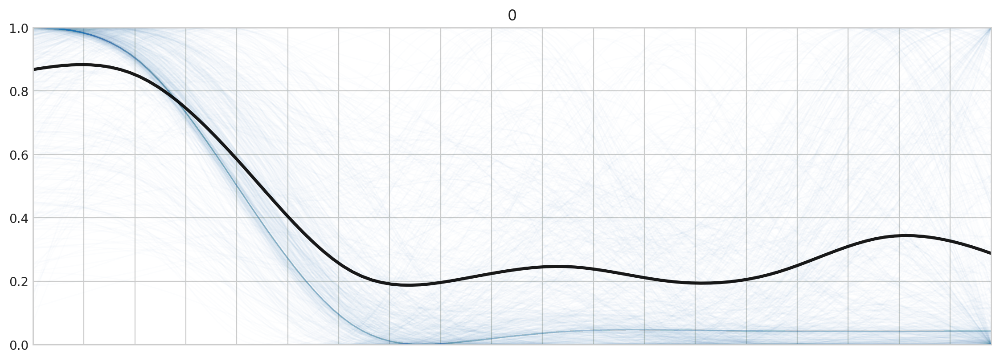

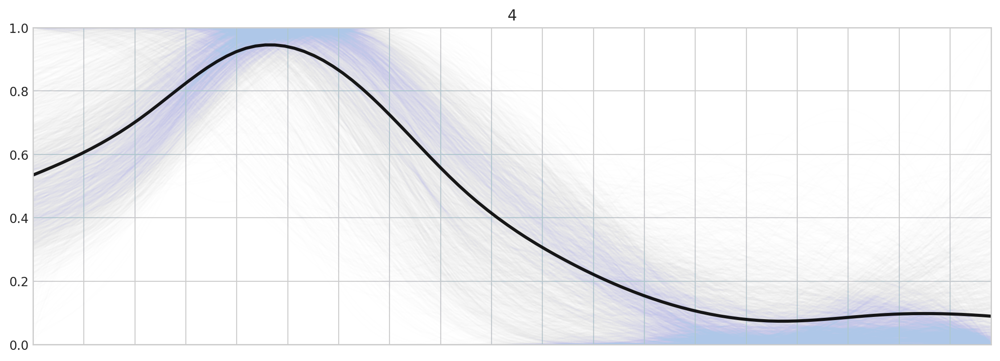

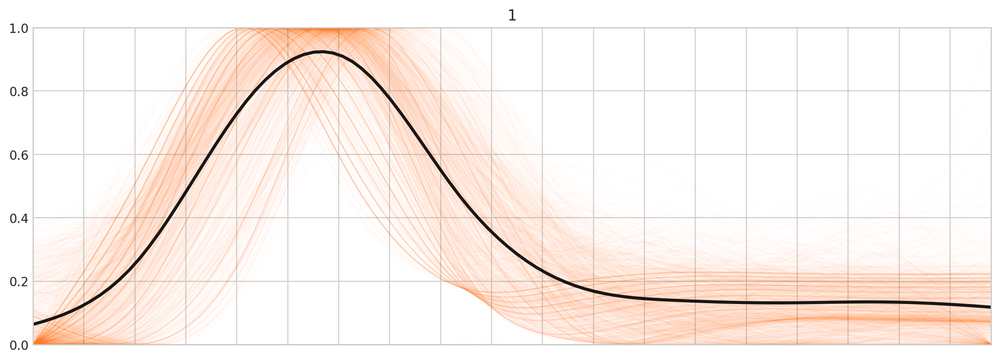

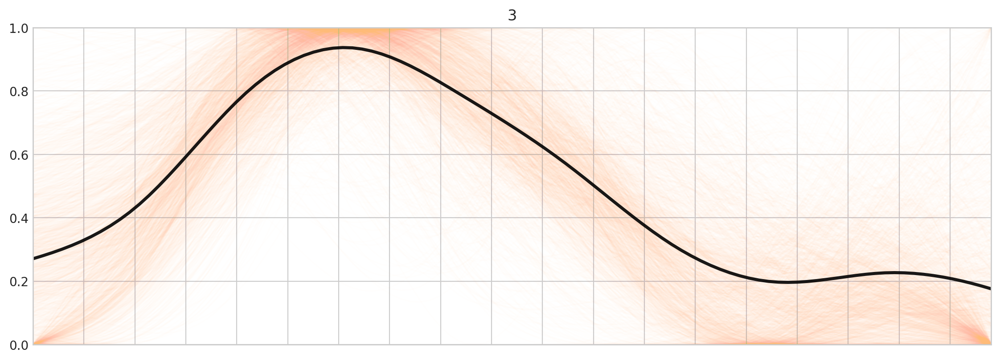

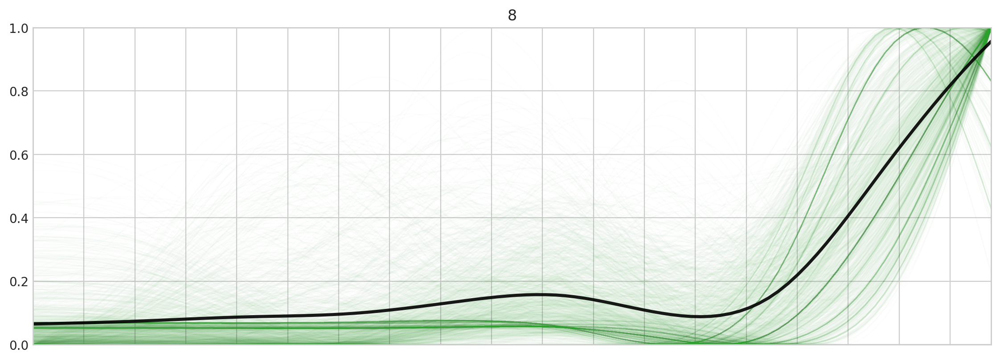

...

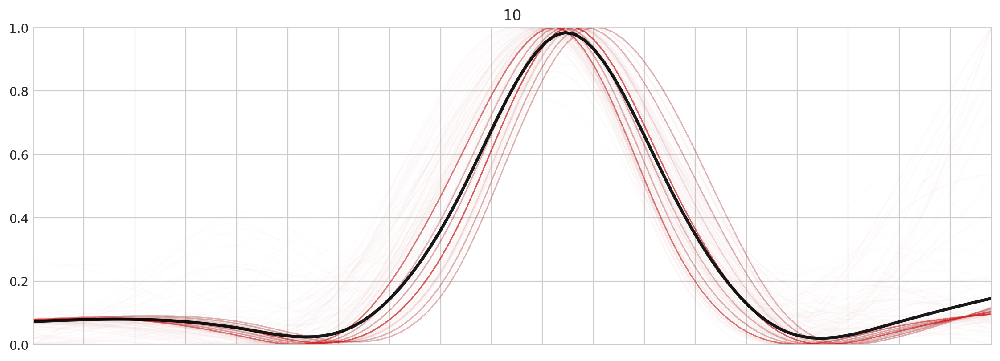

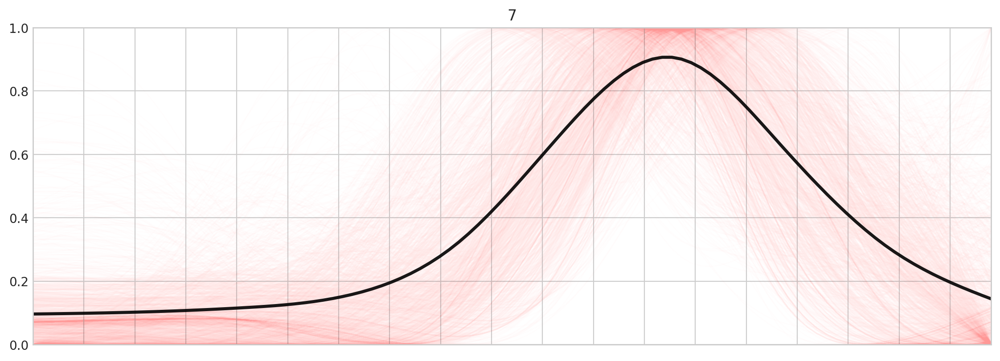

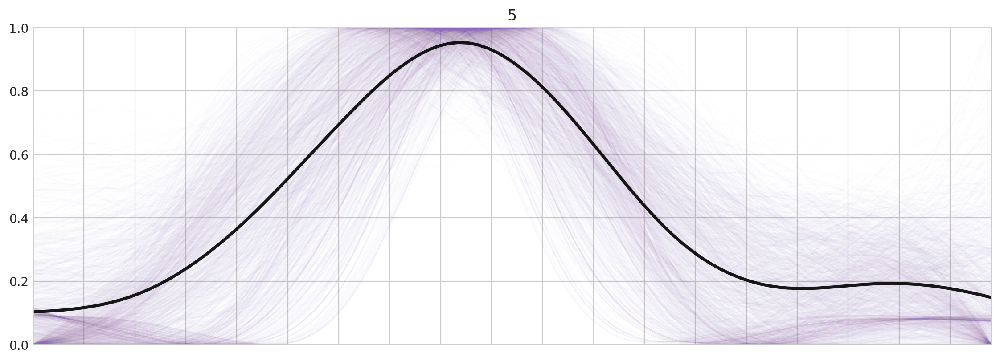

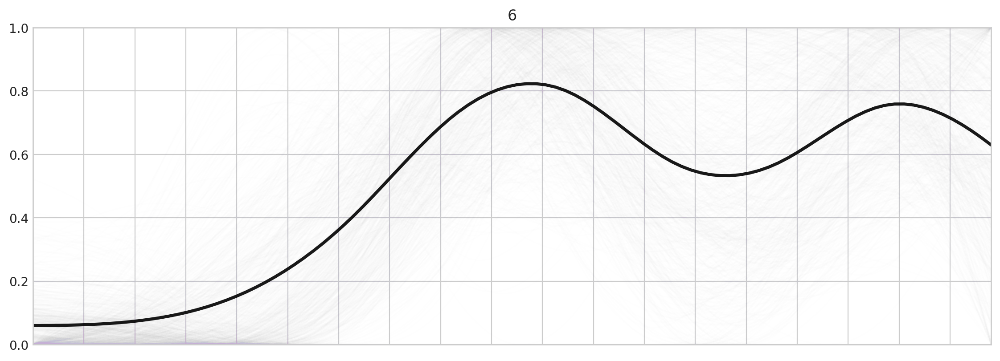

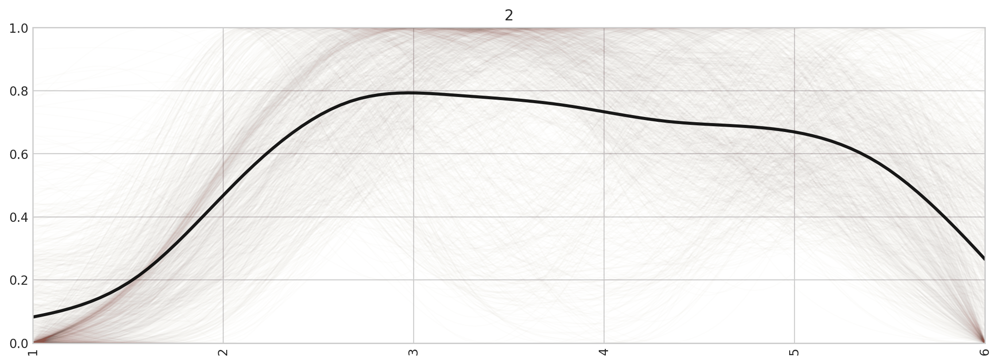

In [76]:
plt.show()